In [0]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

from scipy.integrate import solve_ivp

Reproduction number R0= 0.9956709956709958
Globally asymptotically stable if beta <=d+nu+mu0. This is False
b =  0.01
b =  0.011
b =  0.011999999999999999
b =  0.012999999999999998
b =  0.013999999999999997
b =  0.014999999999999996
b =  0.015999999999999993
b =  0.016999999999999994
b =  0.017999999999999995
b =  0.018999999999999993
b =  0.01999999999999999
b =  0.02099999999999999
b =  0.021999999999999992
b =  0.02299999999999999
b =  0.023999999999999987
b =  0.024999999999999988
b =  0.02599999999999999
b =  0.02699999999999999
b =  0.027999999999999983
b =  0.028999999999999984
b =  0.029999999999999985


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:91: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


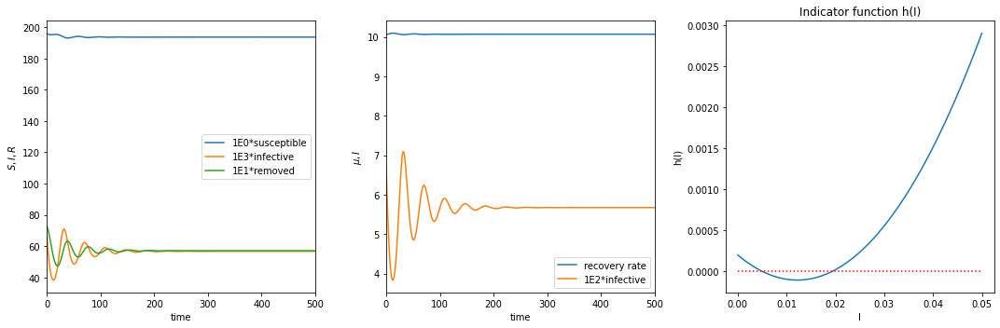

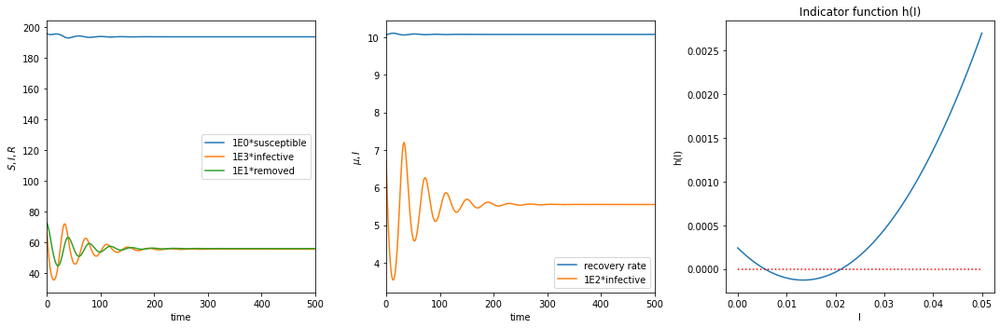

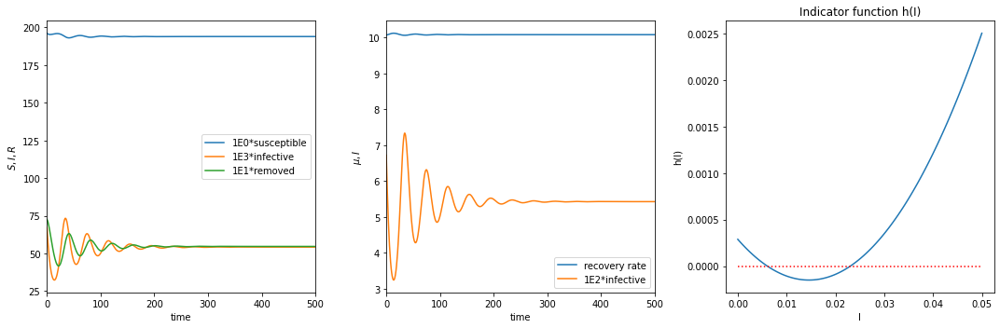

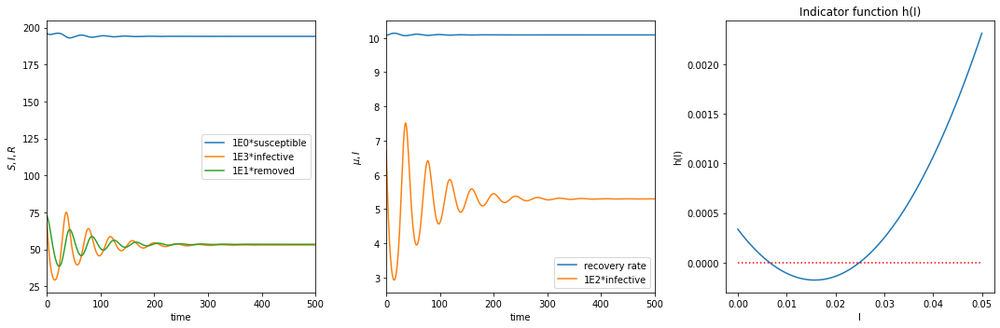

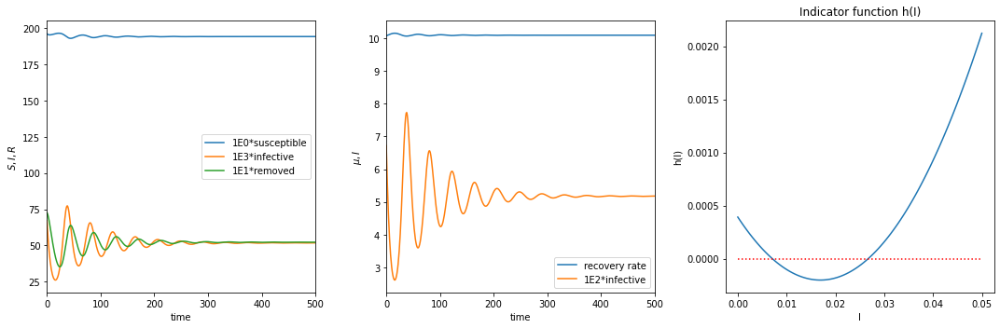

...

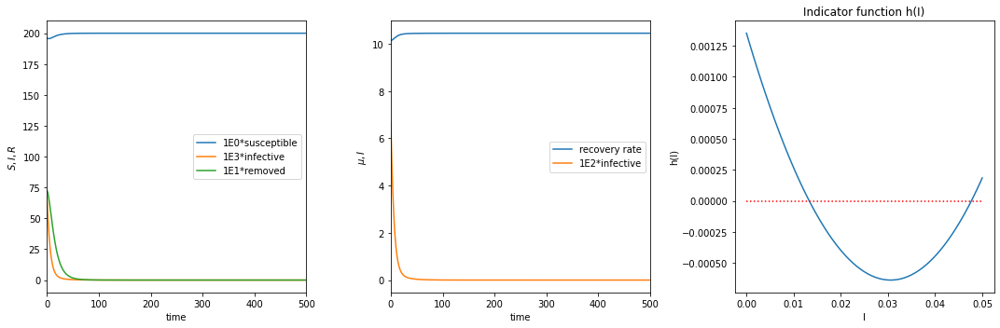

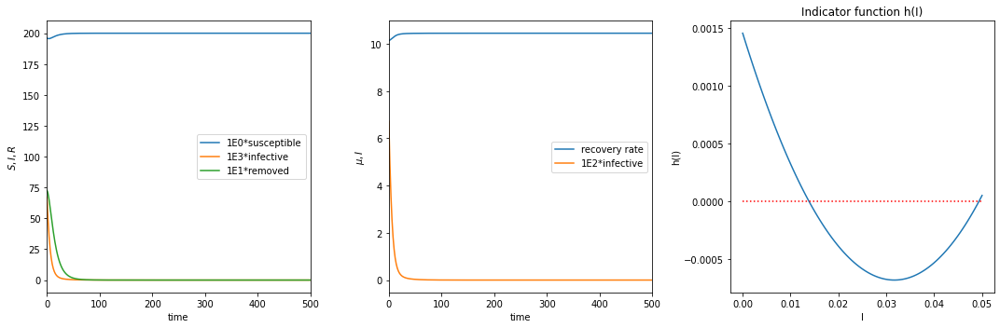

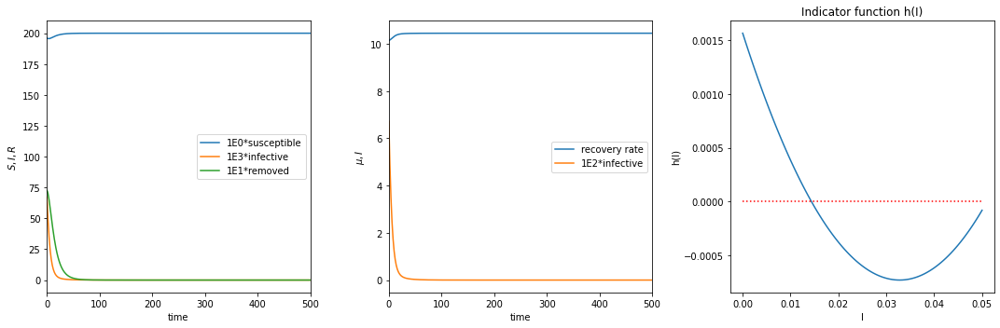

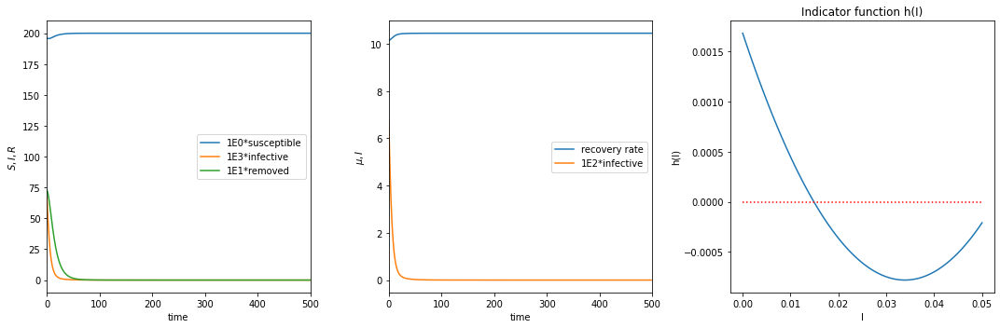

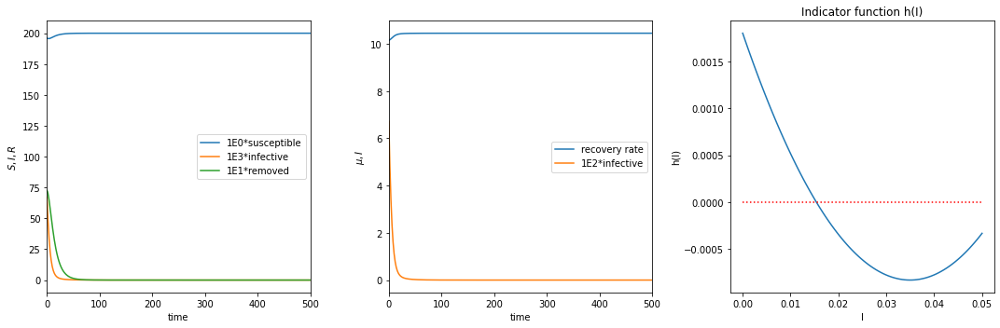

In [2]:
def mu(b, I, mu0, mu1):
    """Recovery rate.
    
    """
    # recovery rate, depends on mu0, mu1, b
    mu = mu0 + (mu1 - mu0) * (b/(I+b))
    return mu

def R0(beta, d, nu, mu1):
    """
    Basic reproduction number.
    """
    return beta / (d + nu + mu1)

def h(I, mu0, mu1, beta, A, d, nu, b):
    """
    Indicator function for bifurcations.
    """
    c0 = b**2 * d * A
    c1 = b * ((mu0-mu1+2*d) * A + (beta-nu)*b*d)
    c2 = (mu1-mu0)*b*nu + 2*b*d*(beta-nu)+d*A
    c3 = d*(beta-nu)
    res = c0 + c1 * I + c2 * I**2 + c3 * I**3
    return res
    

def model(t, y, mu0, mu1, beta, A, d, nu, b):
    """
    SIR model including hospitalization and natural death.
    
    Parameters:
    -----------
    mu0
        Minimum recovery rate
    mu1
        Maximum recovery rate
    beta
        average number of adequate contacts per unit time with infectious individuals
    A
        recruitment rate of susceptibles (e.g. birth rate)
    d
        natural death rate
    nu
        disease induced death rate
    b
        hospital beds per 10,000 persons
    """
    S,I,R = y[:]
    m = mu(b, I, mu0, mu1)
    
    dSdt = A - d * S - (beta * S * I) / (S + I + R)
    dIdt = -(d + nu) * I - m * I + (beta * S * I) / (S + I + R)
    dRdt = m * I - d * R
    
    return [dSdt, dIdt, dRdt]

# parameters
random_state = 12345
t_0 = 0
t_end = 1000
NT = t_end-t_0
# if these error tolerances are set too high, the solution will be qualitatively (!) wrong
rtol=1e-8
atol=1e-8

# SIR model parameters
beta=11.5
A=20
d=0.1
nu=1
b=0.01 # try to set this to 0.01, 0.020, ..., 0.022, ..., 0.03
mu0 = 10   # minimum recovery rate
mu1 = 10.45  # maximum recovery rate

B=np.arange(0.01,0.031,0.001)

# information
print("Reproduction number R0=", R0(beta, d, nu, mu1))
print('Globally asymptotically stable if beta <=d+nu+mu0. This is', beta <= d+nu+mu0)

# simulation
for b in B:
    print("b = ", b)
    rng = np.random.default_rng(random_state)

    SIM0 = rng.uniform(low=(195.3,0.052,4.4), high=(199,0.1,8), size=(3,))

    time = np.linspace(t_0,t_end,NT)
    sol = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0, t_eval=time, args=(mu0, mu1, beta, A, d, nu, b), method='LSODA', rtol=rtol, atol=atol)

    fig,ax = plt.subplots(1,3,figsize=(15,5))
    ax[0].plot(sol.t, sol.y[0]-0*sol.y[0][0], label='1E0*susceptible');
    ax[0].plot(sol.t, 1e3*sol.y[1]-0*sol.y[1][0], label='1E3*infective');
    ax[0].plot(sol.t, 1e1*sol.y[2]-0*sol.y[2][0], label='1E1*removed');
    ax[0].set_xlim([0, 500])
    ax[0].legend();
    ax[0].set_xlabel("time")
    ax[0].set_ylabel(r"$S,I,R$")

    ax[1].plot(sol.t, mu(b, sol.y[1], mu0, mu1), label='recovery rate')
    ax[1].plot(sol.t, 1e2*sol.y[1], label='1E2*infective');
    ax[1].set_xlim([0, 500])
    ax[1].legend();
    ax[1].set_xlabel("time")
    ax[1].set_ylabel(r"$\mu,I$")

    I_h = np.linspace(-0.,0.05,100)
    ax[2].plot(I_h, h(I_h, mu0, mu1, beta, A, d, nu, b));
    ax[2].plot(I_h, 0*I_h, 'r:')
    #ax[2].set_ylim([-0.1,0.05])
    ax[2].set_title("Indicator function h(I)")
    ax[2].set_xlabel("I")
    ax[2].set_ylabel("h(I)")

    fig.tight_layout()

In [0]:
# parameters
random_state = 12345
t_0 = 0
t_end = 1000
NT = t_end-t_0
# if these error tolerances are set too high, the solution will be qualitatively (!) wrong
rtol=1e-8
atol=1e-8

# SIR model parameters
BETA=np.arange(-15,15,0.01)
A=20
d=0.1
nu=1
b=0.01 # try to set this to 0.01, 0.020, ..., 0.022, ..., 0.03
mu0 = 10   # minimum recovery rate
mu1 = 10.45  # maximum recovery rate
rng = np.random.default_rng(random_state)
SIM0 = rng.uniform(low=(195.3,0.052,4.4), high=(199,0.1,8), size=(3,))

final_I = []

for beta in BETA:
    
    time = np.linspace(t_0,t_end,NT)
    sol = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0, t_eval=time, args=(mu0, mu1, beta, A, d, nu, b), method='LSODA', rtol=rtol, atol=atol).y
    final_I.append(sol[1][-1])
    
final_I = np.array(final_I)


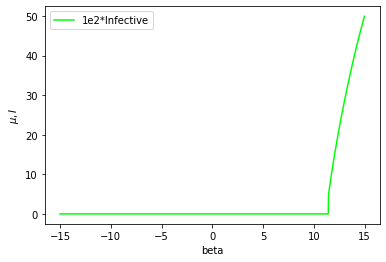

In [4]:
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(BETA, 1e2*final_I, label='1e2*Infective', color = '#01ff07');
#ax[1].set_xlim([0, 500])
ax.legend();
ax.set_xlabel("beta")
ax.set_ylabel(r"$\mu,I$")
plt.show()

"for b1 in B: \n    #sol = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_1, t_eval=time, args=(mu0, mu1, beta, A, d, nu, 0.02), method='DOP853', rtol=rtol, atol=atol)\n\n    sol = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_2, t_eval=time,args=(mu0, mu1, beta, A, d, nu, b1), method='DOP853', rtol=rtol, atol=atol)\n    #print(sol.y)\n    ax.scatter(sol.y[0], sol.y[1], sol.y[2], s=1, c=time, cmap=cmap);\n"

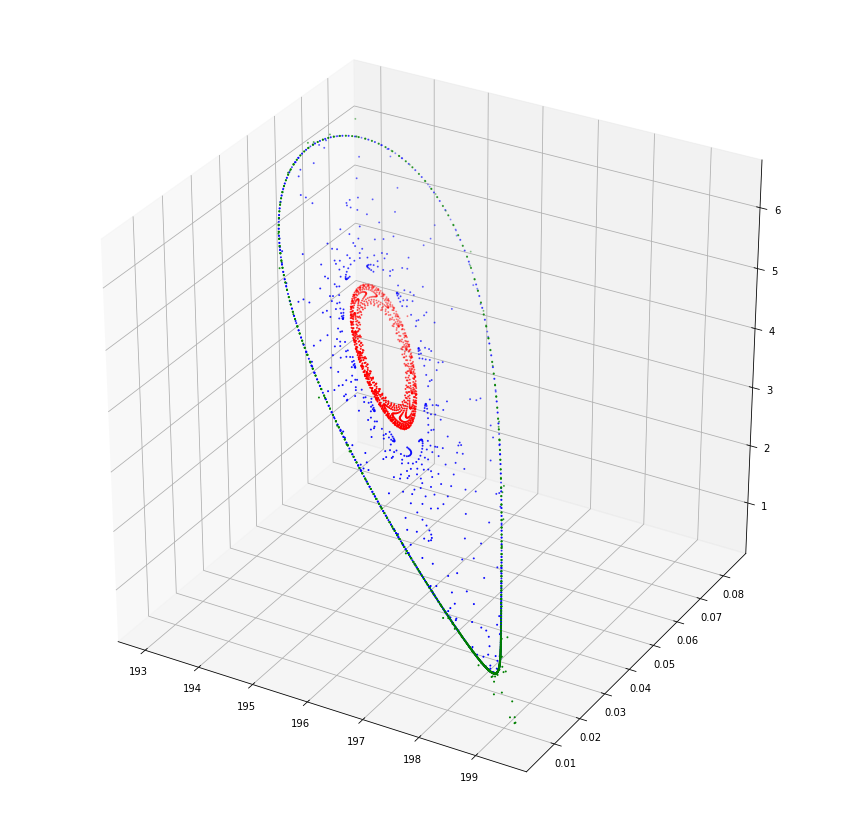

In [5]:
# add legend and make fig bigger

# parameters
random_state = 12345
t_0 = 0
t_end = 1000
NT = t_end-t_0
# if these error tolerances are set too high, the solution will be qualitatively (!) wrong
rtol=1e-8
atol=1e-8

# SIR model parameters
beta=11.5
A=20
d=0.1
nu=1
#b=0.01 # try to set this to 0.01, 0.020, ..., 0.022, ..., 0.03
mu0 = 10   # minimum recovery rate
mu1 = 10.45  # maximum recovery rate


fig=plt.figure(figsize=(15,15))
ax=fig.add_subplot(111,projection="3d")
time = np.linspace(t_0,15000,NT)

SIM0_1 = [195.7, 0.03, 3.92] # what happens with this initial condition when b=0. 􏰀→022?
B=np.arange(0.02,0.024,0.0001)
SIM0_2 = [195.3, 0.052, 4.4]
SIM0_3 = [193, 0.08, 6.21]


sol = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_1, t_eval=time,args=(mu0, mu1, beta, A, d, nu, 0.022), method='DOP853', rtol=rtol, atol=atol)
ax.scatter(sol.y[0], sol.y[1], sol.y[2], s=1, c='blue');
sol = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_2, t_eval=time,args=(mu0, mu1, beta, A, d, nu, 0.022), method='DOP853', rtol=rtol, atol=atol)
ax.scatter(sol.y[0], sol.y[1], sol.y[2], s=1, c='red');
sol = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_3, t_eval=time,args=(mu0, mu1, beta, A, d, nu, 0.022), method='DOP853', rtol=rtol, atol=atol)

ax.scatter(sol.y[0], sol.y[1], sol.y[2], s=1, c='green');
    


In [0]:
def my_ceil(a, precision=0):
    return np.round(a + 0.5 * 10**(-precision), precision)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:42: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


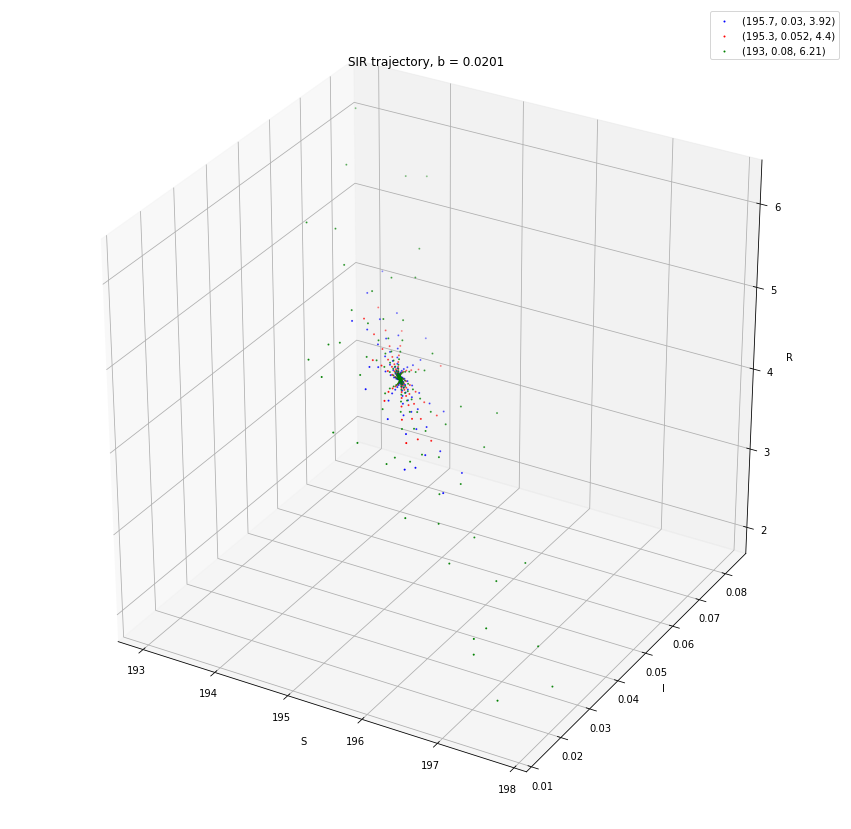

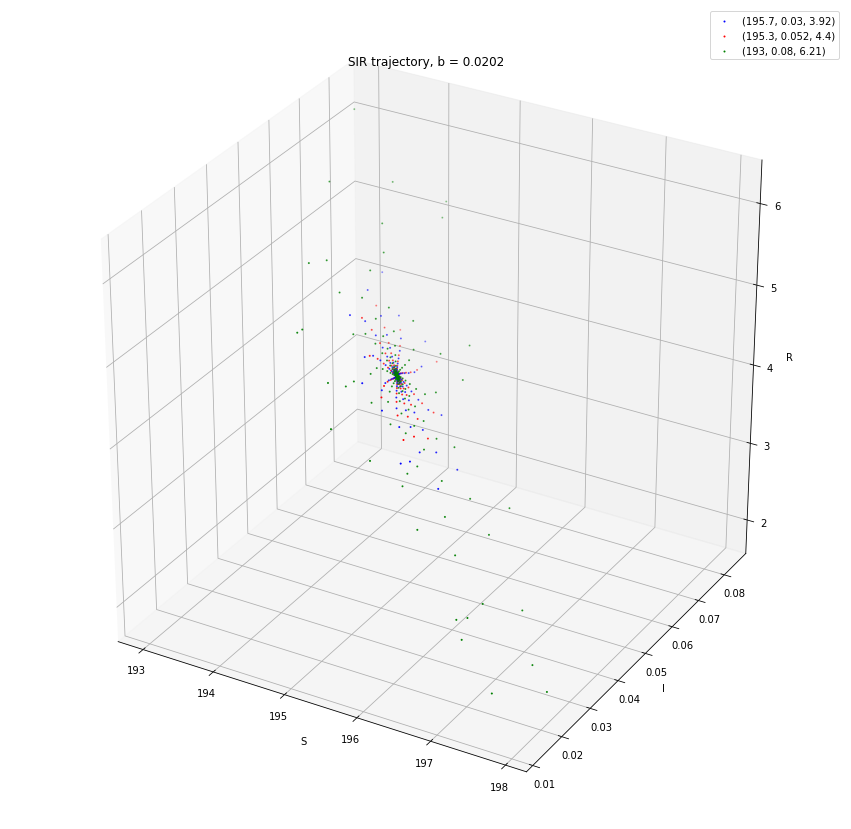

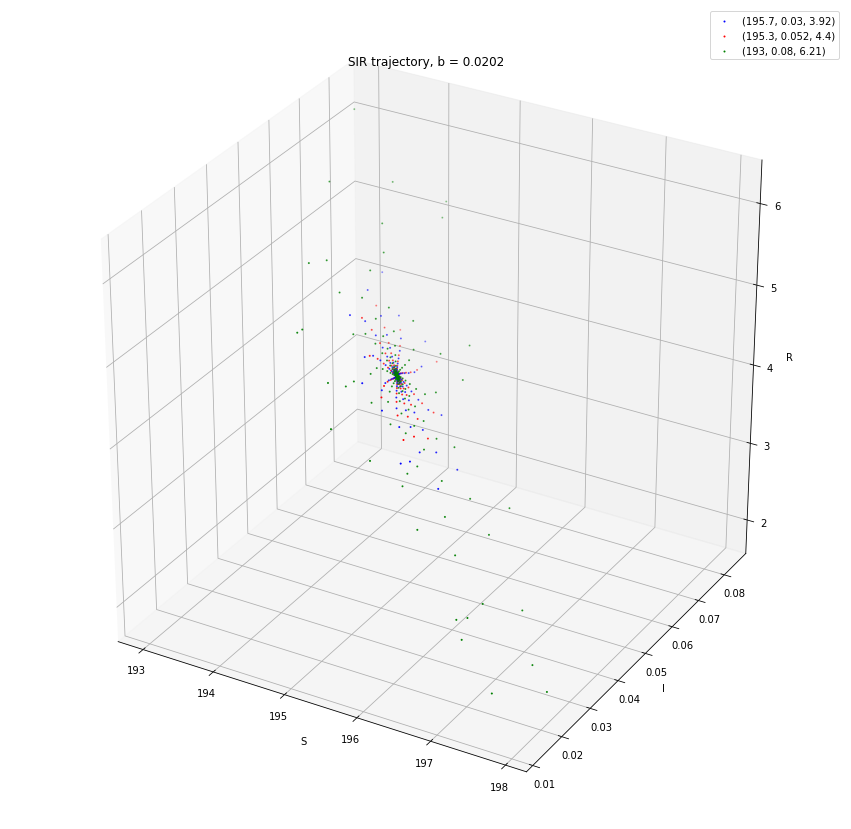

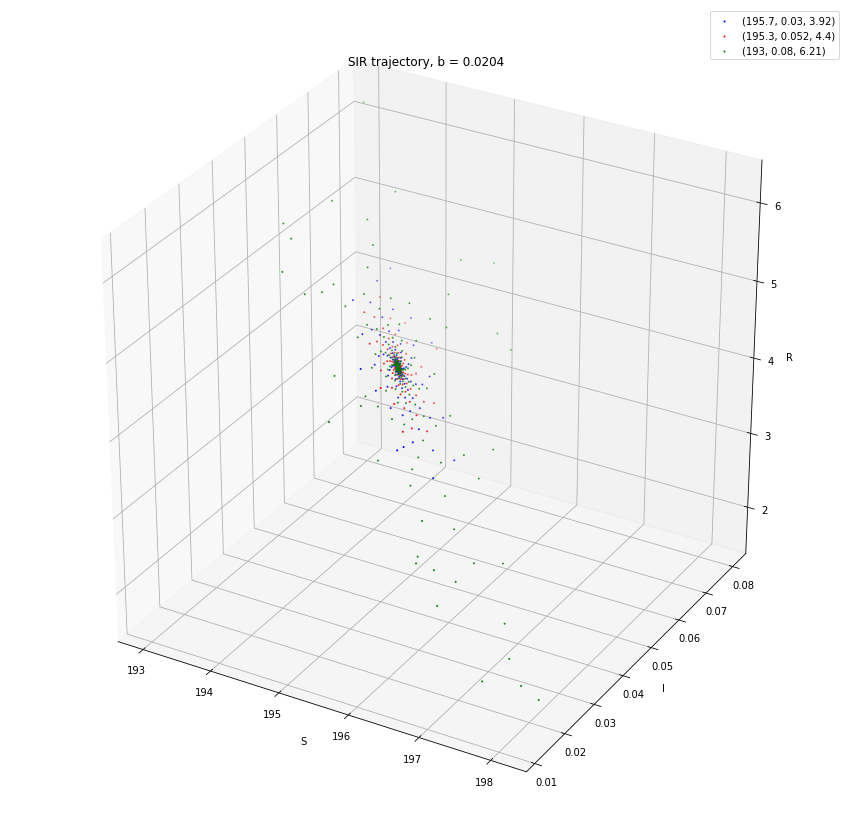

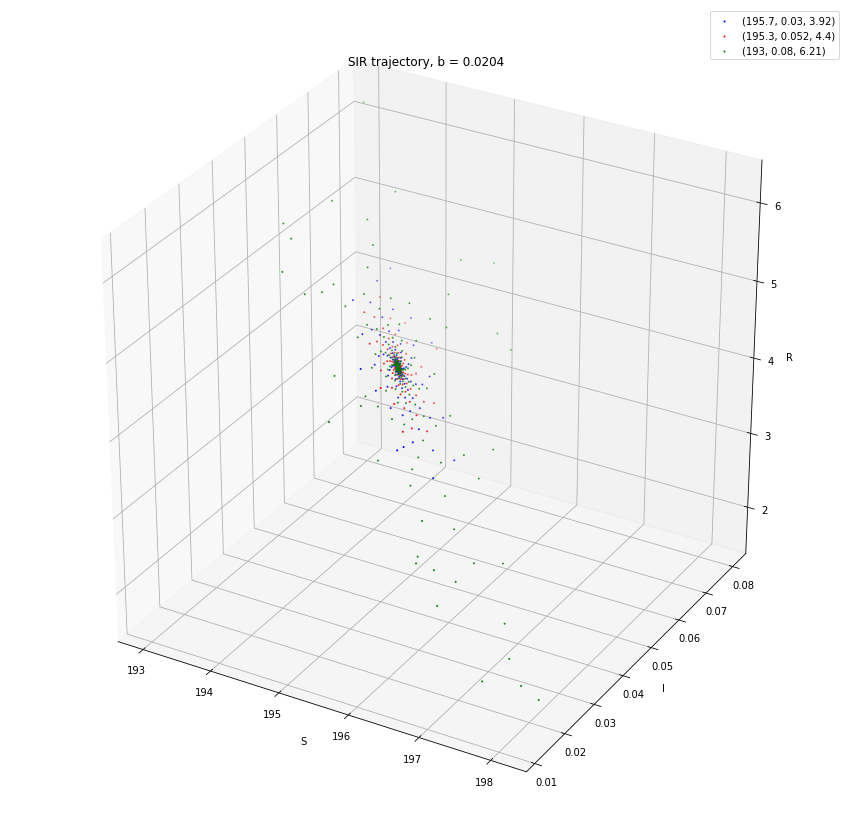

...

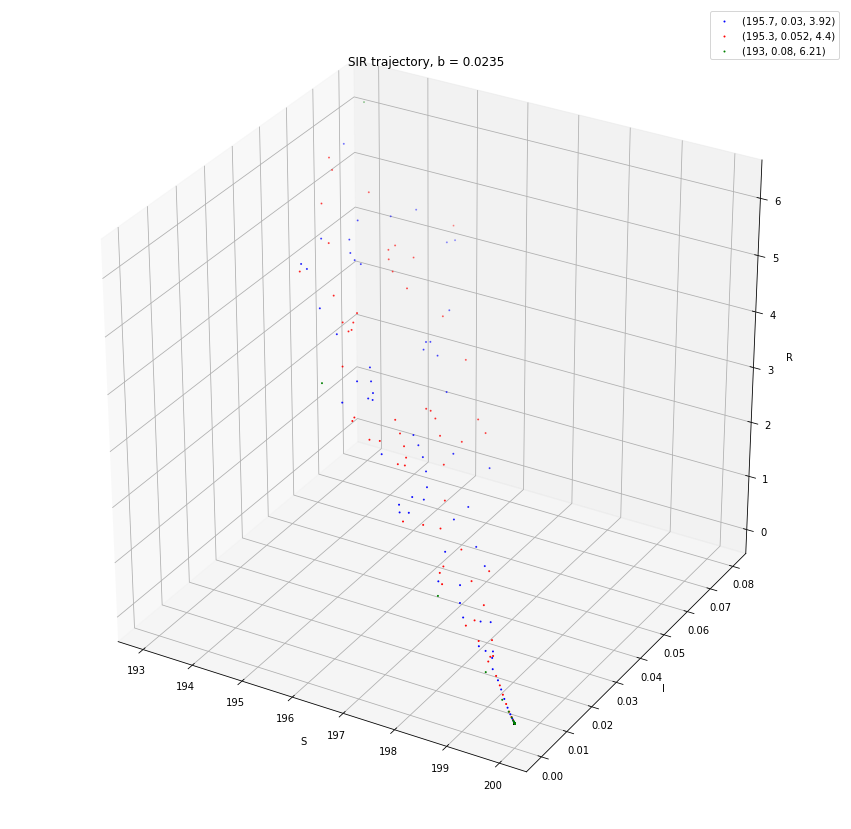

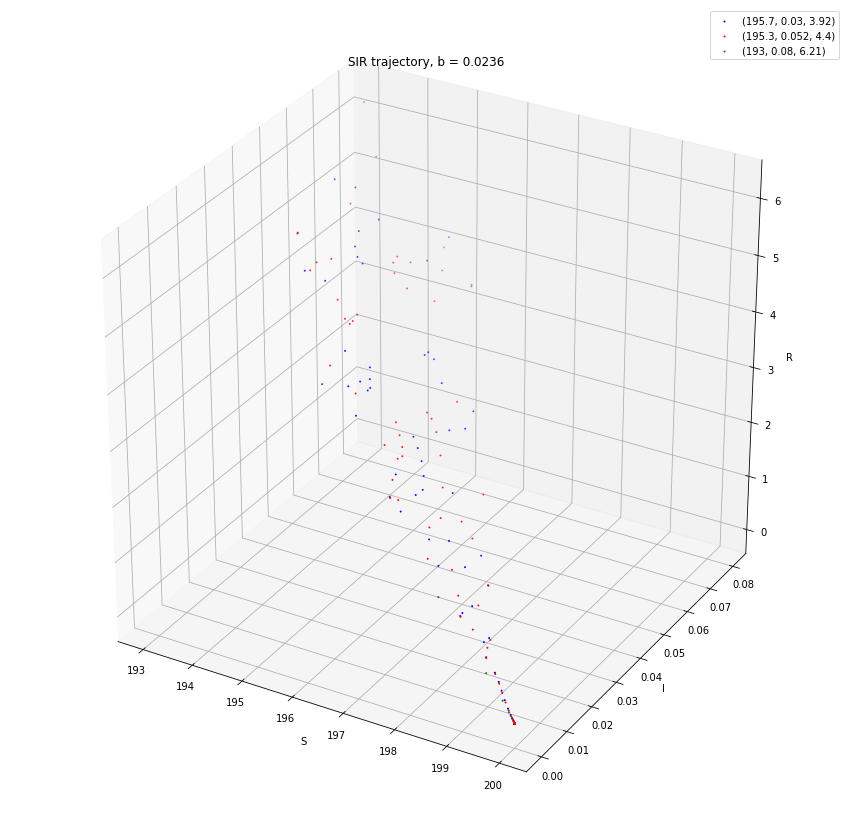

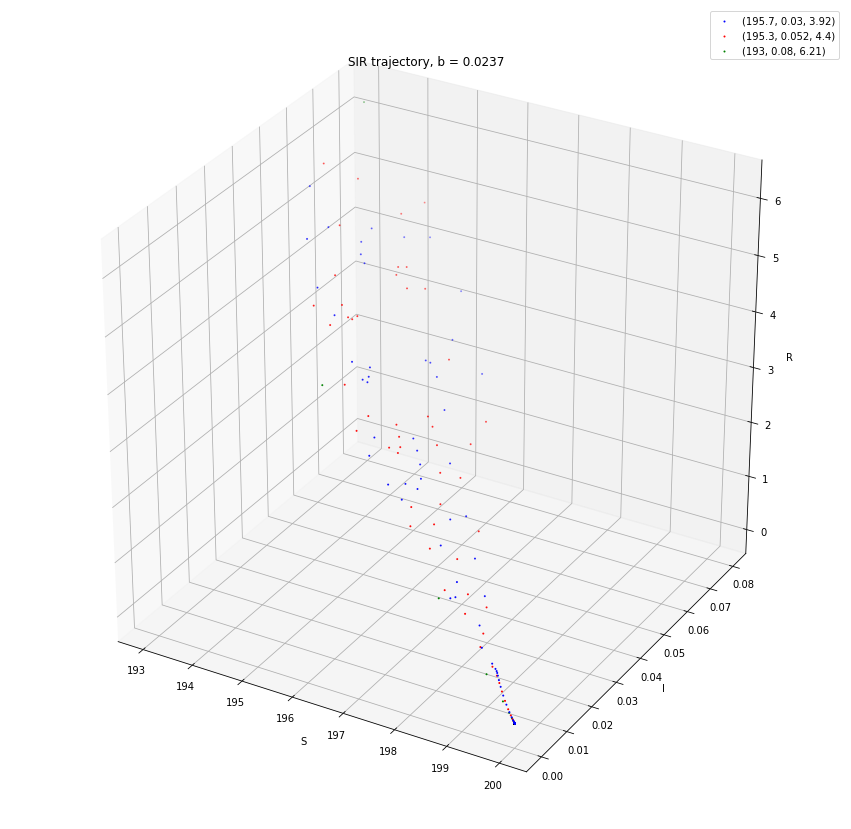

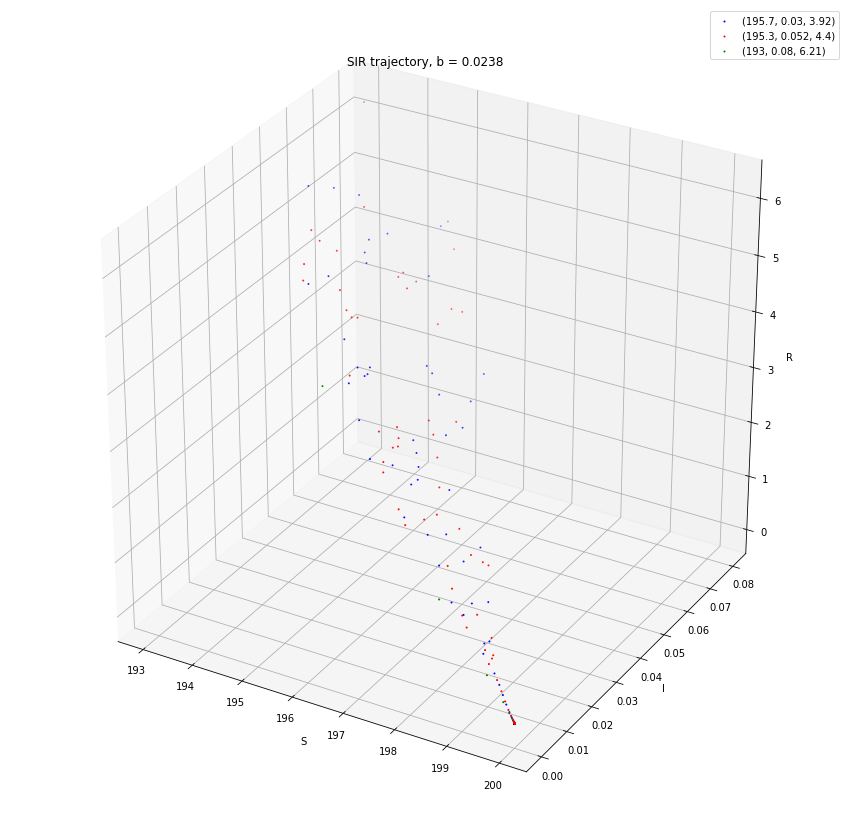

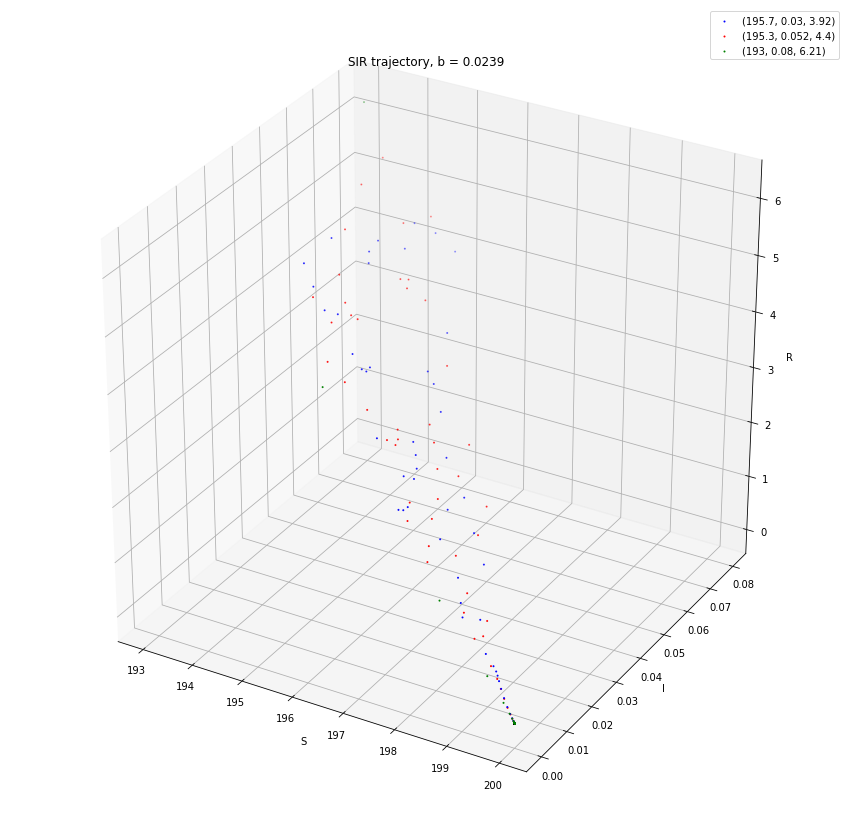

In [7]:
# add legend and make fig bigger

# parameters
random_state = 12345
t_0 = 0
t_end = 1000
NT = t_end-t_0
# if these error tolerances are set too high, the solution will be qualitatively (!) wrong
rtol=1e-8
atol=1e-8

# SIR model parameters
beta=11.5
A=20
d=0.1
nu=1
#b=0.01 # try to set this to 0.01, 0.020, ..., 0.022, ..., 0.03
mu0 = 10   # minimum recovery rate
mu1 = 10.45  # maximum recovery rate

B=np.arange(0.02,0.024,0.0001)
for i in range(len(B)):
    B[i] = my_ceil(B[i],4)

SIM0_1 = [195.7, 0.03, 3.92] # what happens with this initial condition when b=0. 􏰀→022?
SIM0_2 = [195.3, 0.052, 4.4]
SIM0_3 = [193, 0.08, 6.21]

    
for i in range(len(B)):
    fig1=plt.figure(figsize=(15,15))
    ax0=fig1.add_subplot(projection="3d")
    
    sol1 = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_1, t_eval=time,args=(mu0, mu1, beta, A, d, nu, B[i]), method='DOP853', rtol=rtol, atol=atol)
    ax0.scatter(sol1.y[0], sol1.y[1], sol1.y[2], s=1, c='blue',label="(195.7, 0.03, 3.92)");
    sol2 = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_2, t_eval=time,args=(mu0, mu1, beta, A, d, nu, B[i]), method='DOP853', rtol=rtol, atol=atol)
    ax0.scatter(sol2.y[0], sol2.y[1], sol2.y[2], s=1, c='red',label="(195.3, 0.052, 4.4)");
    sol3 = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_3, t_eval=time,args=(mu0, mu1, beta, A, d, nu, B[i]), method='DOP853', rtol=rtol, atol=atol)
    ax0.scatter(sol3.y[0], sol3.y[1], sol3.y[2], s=1, c='green',label="(193, 0.08, 6.21)");
    
    ax0.legend() 
    ax0.set_xlabel("S")
    ax0.set_ylabel("I")
    ax0.set_zlabel("R")
    ax0.set_title("SIR trajectory, b = {}".format(B[i]))
    fig1.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:42: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


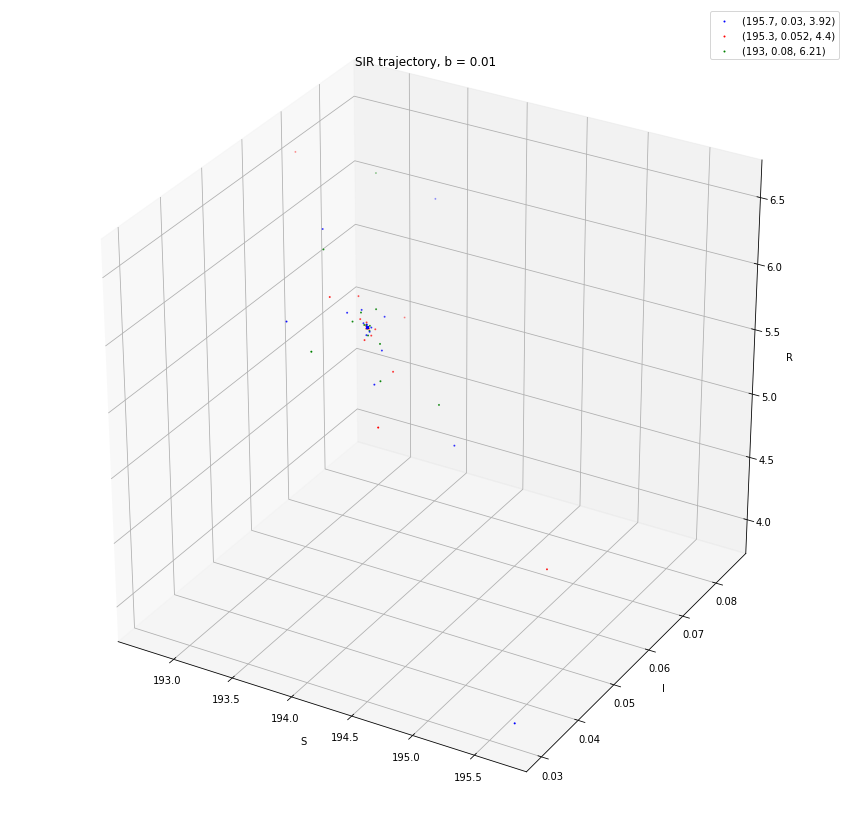

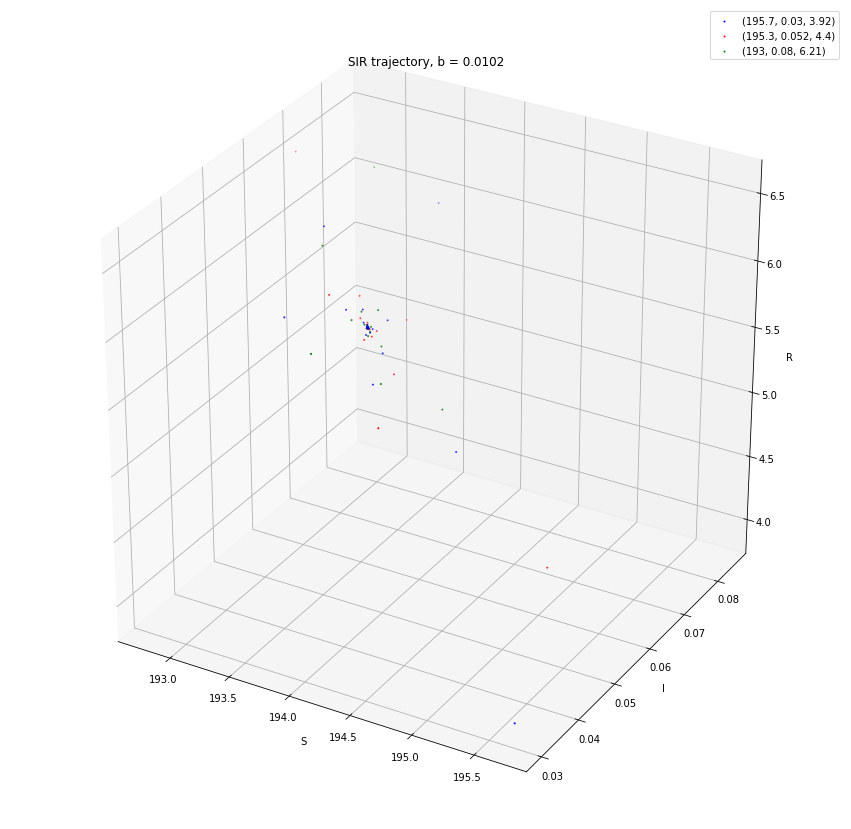

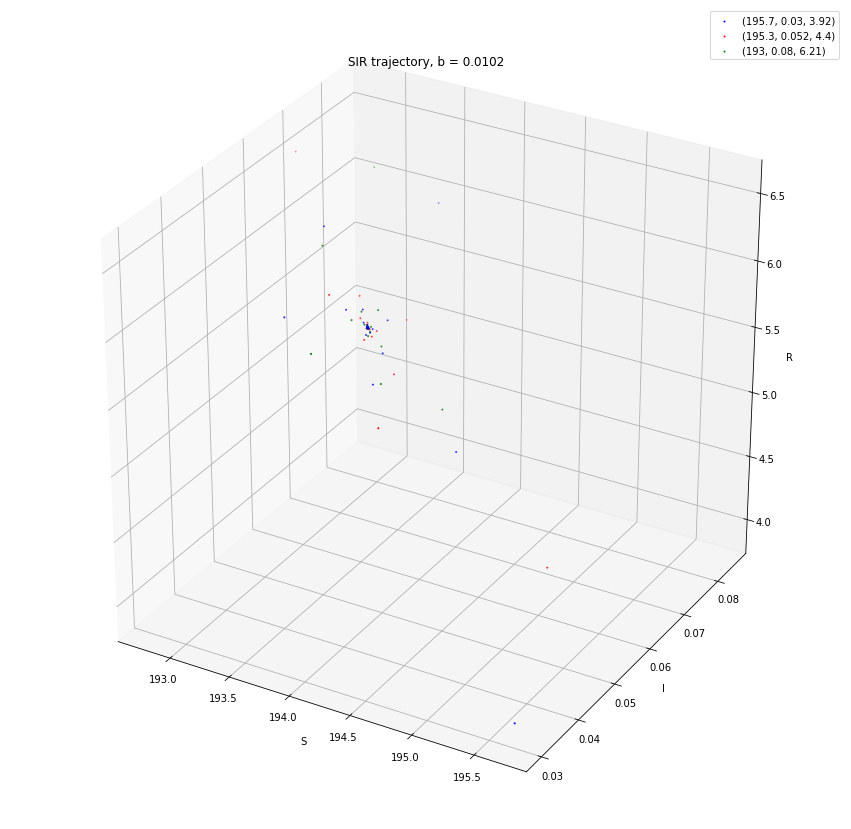

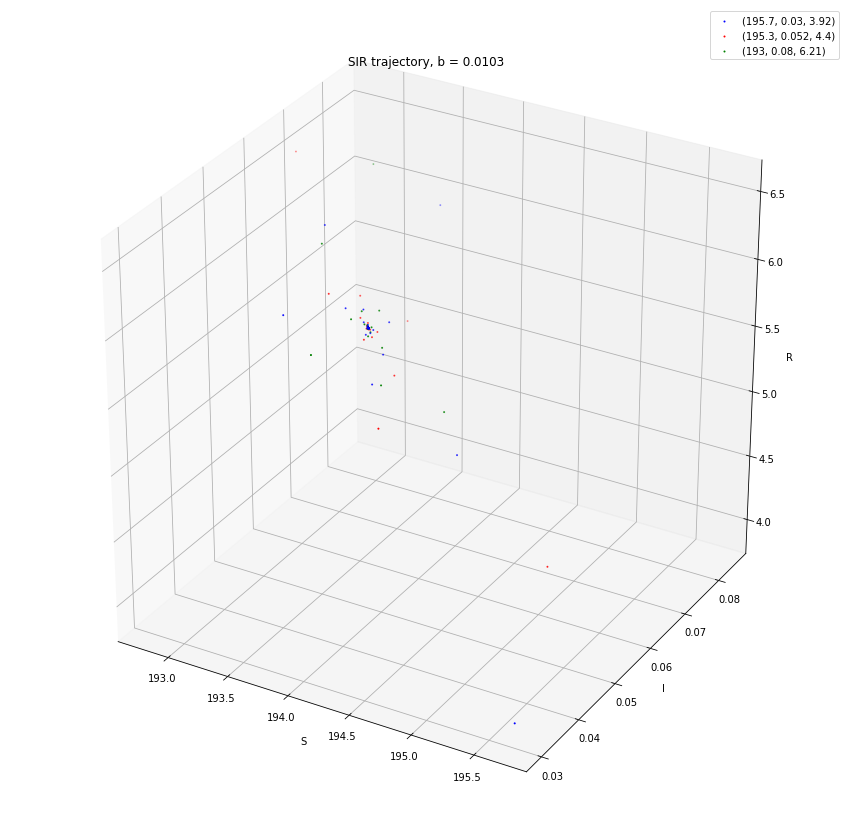

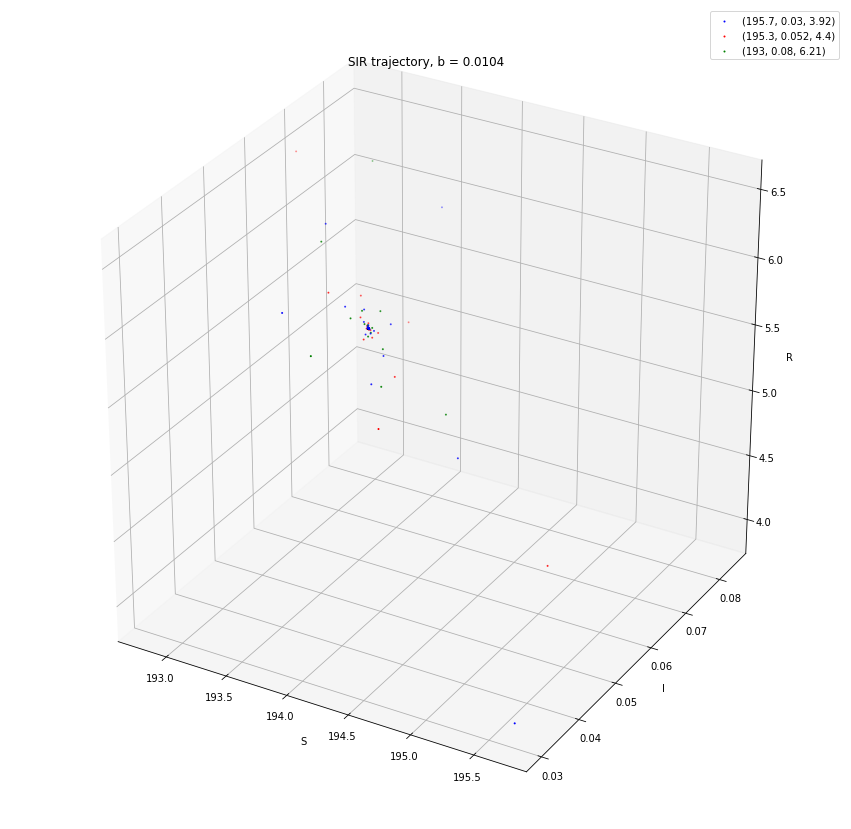

...

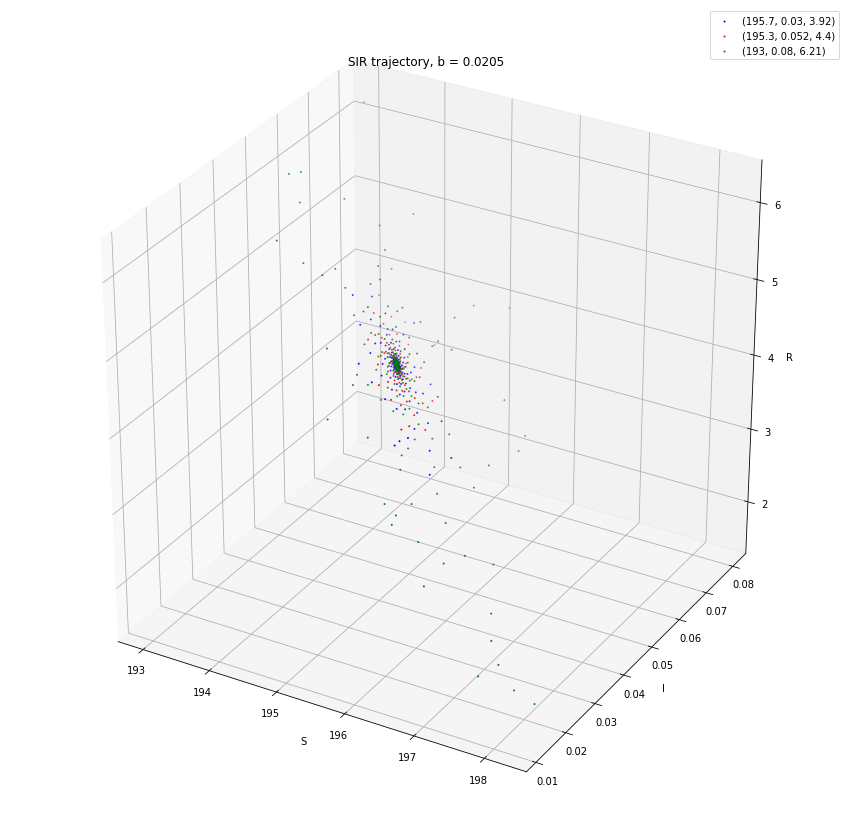

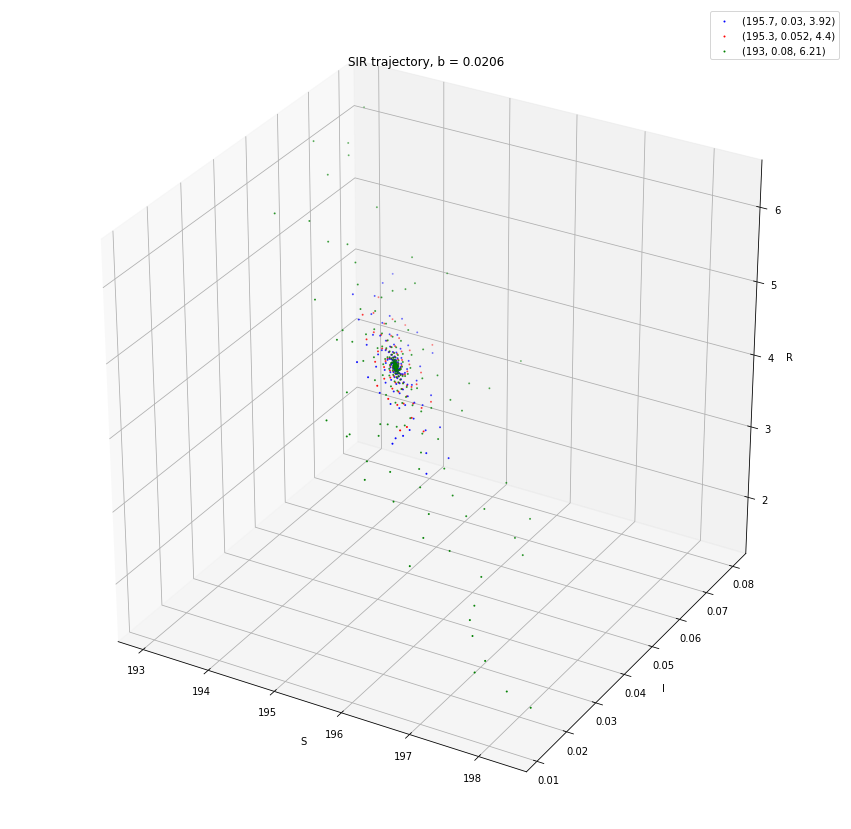

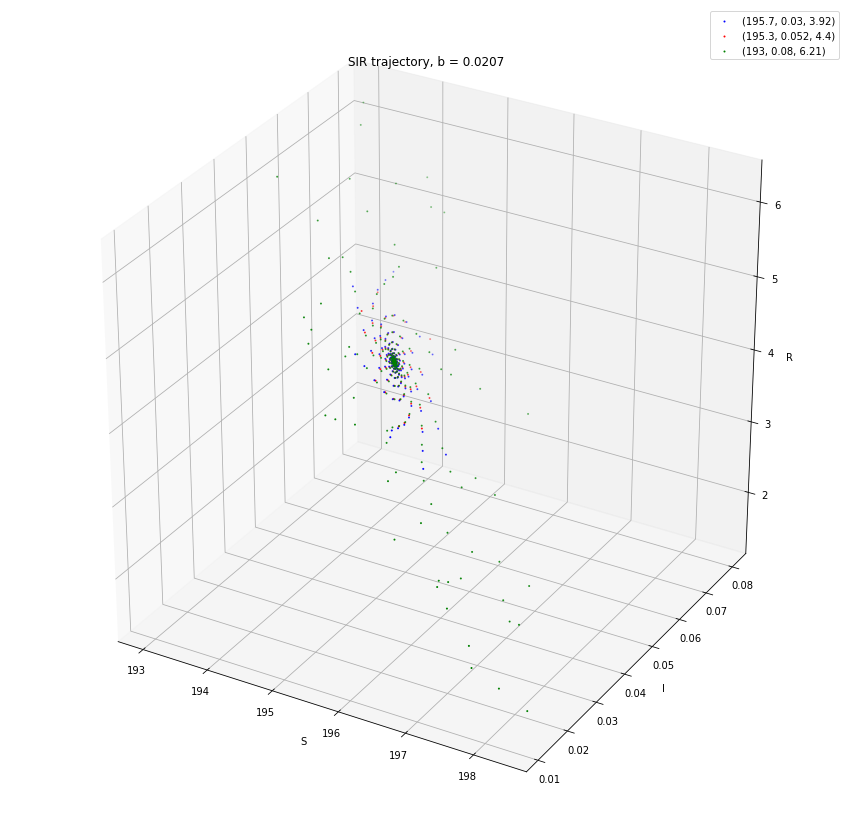

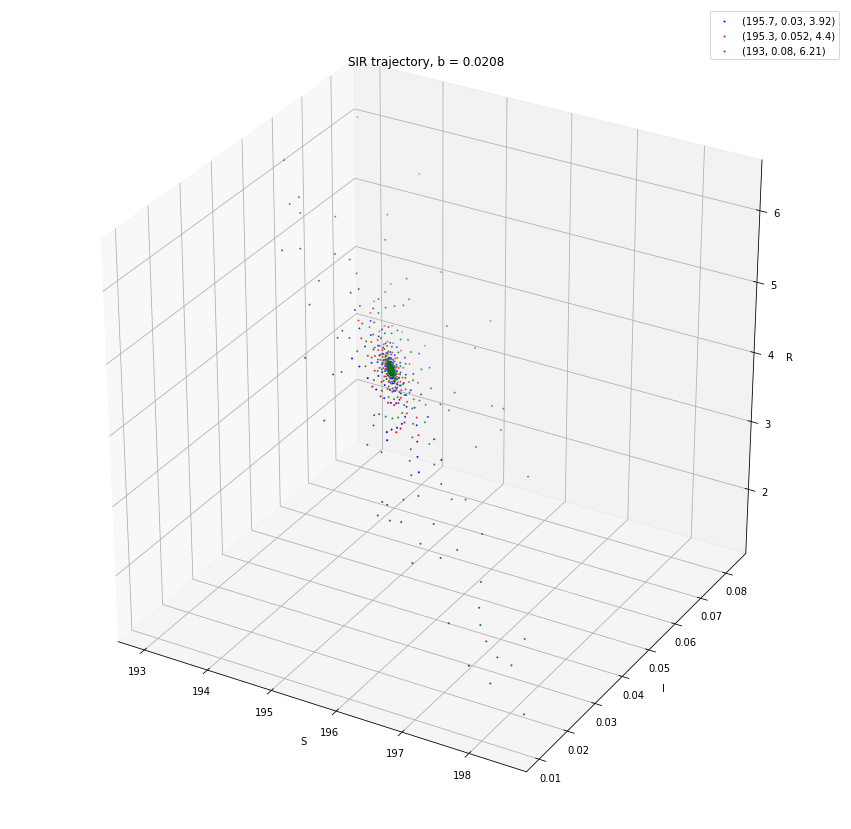

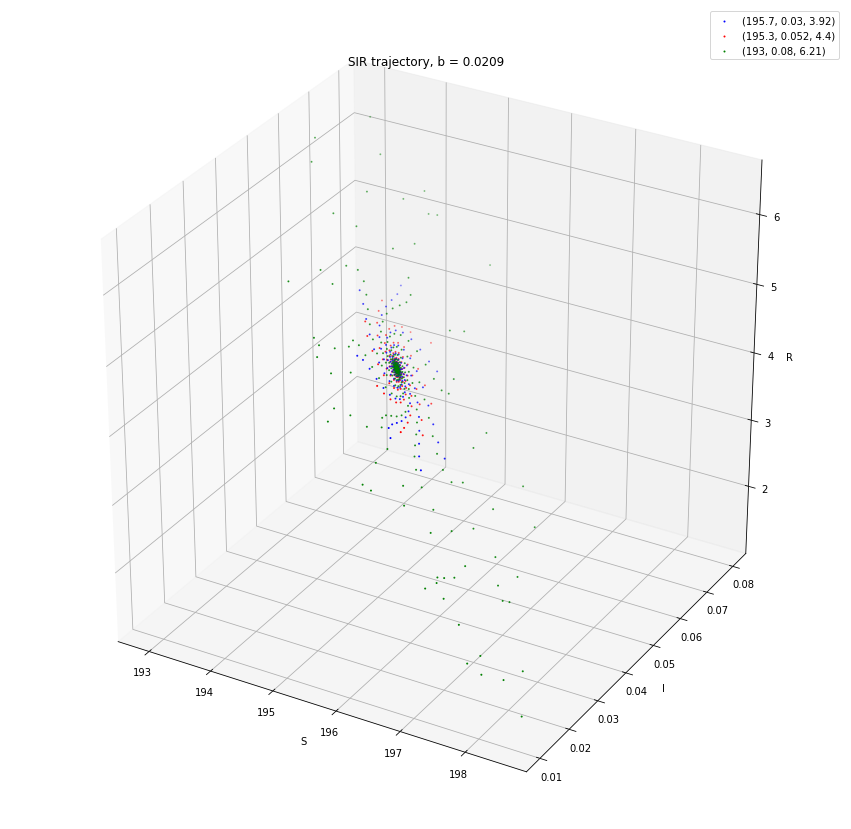

In [8]:
# add legend and make fig bigger

# parameters
random_state = 12345
t_0 = 0
t_end = 1000
NT = t_end-t_0
# if these error tolerances are set too high, the solution will be qualitatively (!) wrong
rtol=1e-8
atol=1e-8

# SIR model parameters
beta=11.5
A=20
d=0.1
nu=1
#b=0.01 # try to set this to 0.01, 0.020, ..., 0.022, ..., 0.03
mu0 = 10   # minimum recovery rate
mu1 = 10.45  # maximum recovery rate


B=np.arange(0.01,0.021,0.0001)
for i in range(len(B)):
    B[i] = my_ceil(B[i],4)

SIM0_1 = [195.7, 0.03, 3.92] # what happens with this initial condition when b=0. 􏰀→022?
SIM0_2 = [195.3, 0.052, 4.4]
SIM0_3 = [193, 0.08, 6.21]

    
for i in range(len(B)):
    fig1=plt.figure(figsize=(15,15))
    ax0=fig1.add_subplot(projection="3d")
    
    sol1 = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_1, t_eval=time,args=(mu0, mu1, beta, A, d, nu, B[i]), method='DOP853', rtol=rtol, atol=atol)
    ax0.scatter(sol1.y[0], sol1.y[1], sol1.y[2], s=1, c='blue',label="(195.7, 0.03, 3.92)");
    sol2 = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_2, t_eval=time,args=(mu0, mu1, beta, A, d, nu, B[i]), method='DOP853', rtol=rtol, atol=atol)
    ax0.scatter(sol2.y[0], sol2.y[1], sol2.y[2], s=1, c='red',label="(195.3, 0.052, 4.4)");
    sol3 = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_3, t_eval=time,args=(mu0, mu1, beta, A, d, nu, B[i]), method='DOP853', rtol=rtol, atol=atol)
    ax0.scatter(sol3.y[0], sol3.y[1], sol3.y[2], s=1, c='green',label="(193, 0.08, 6.21)");
    
    ax0.legend() 
    ax0.set_xlabel("S")
    ax0.set_ylabel("I")
    ax0.set_zlabel("R")
    ax0.set_title("SIR trajectory, b = {}".format(B[i]))
    fig1.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:42: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


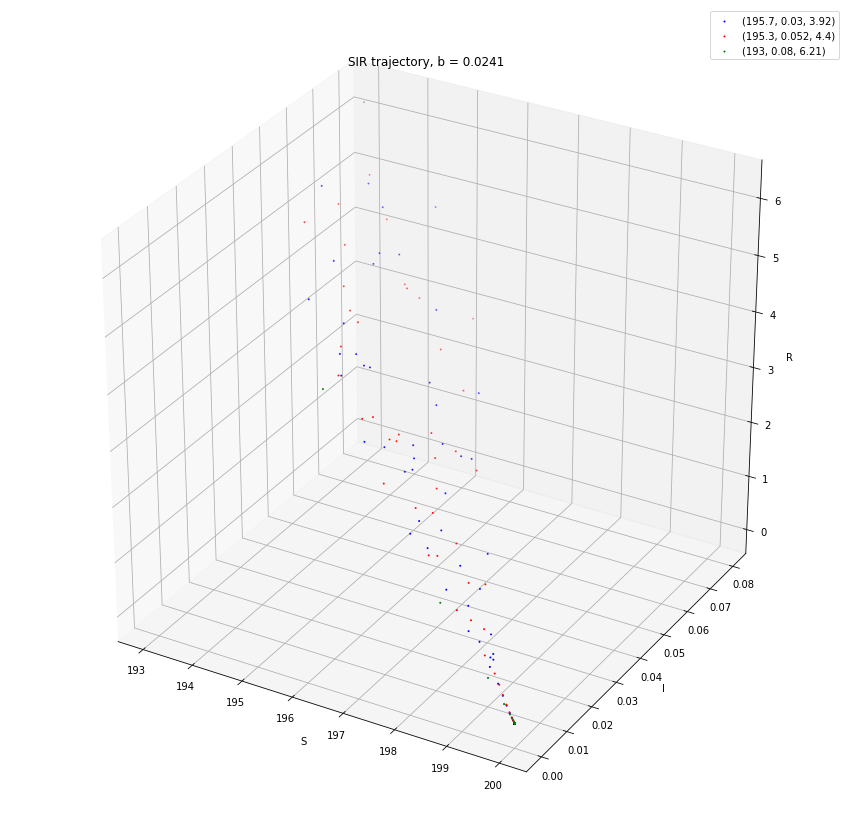

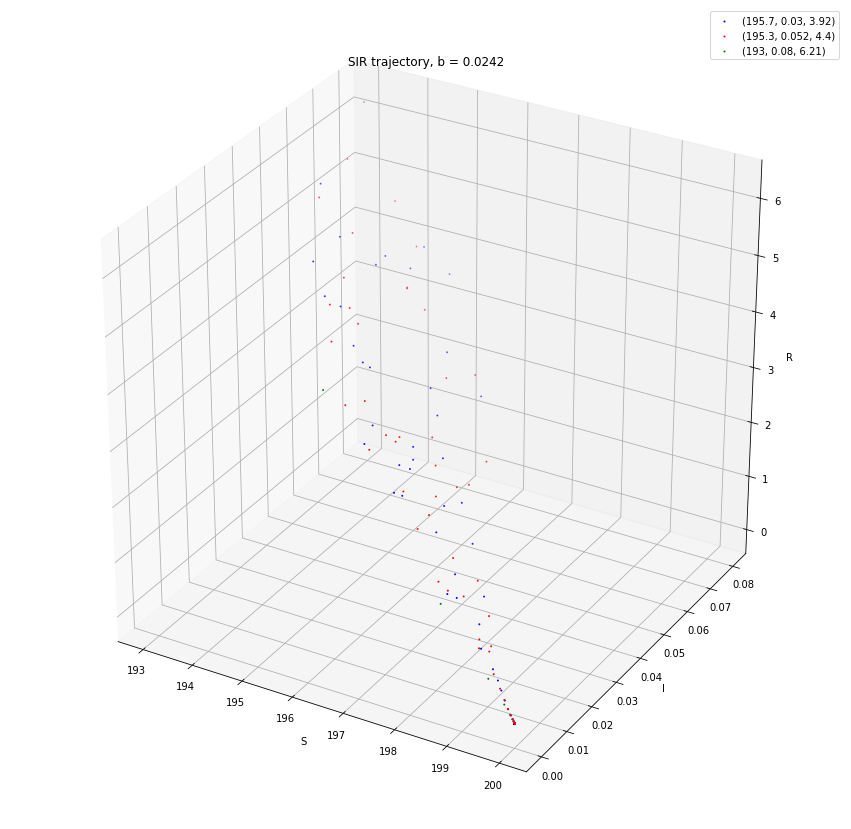

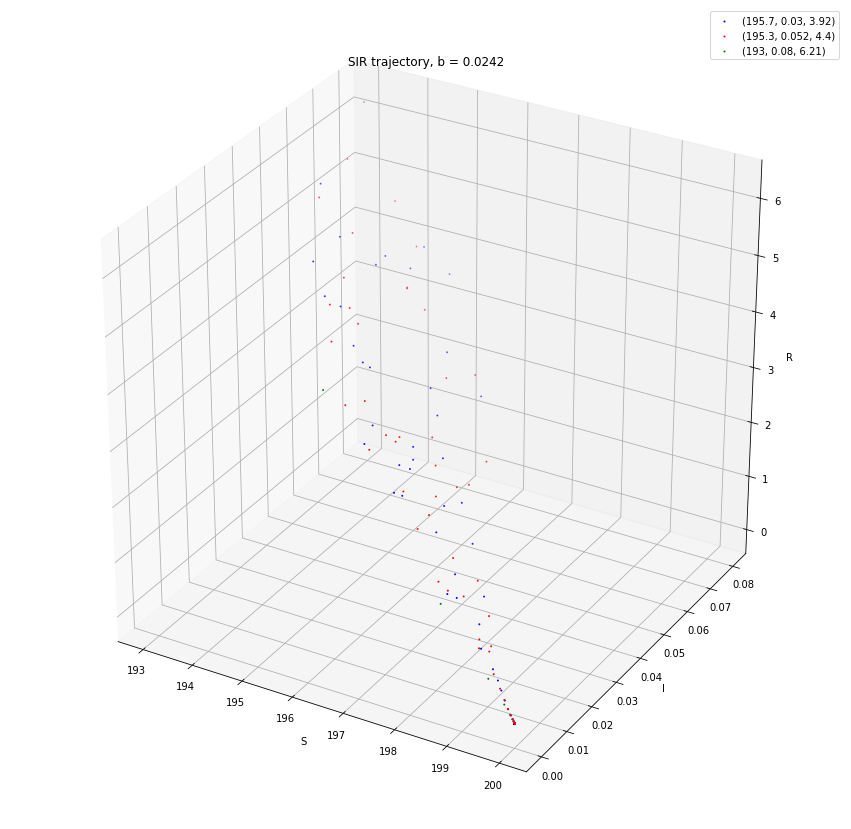

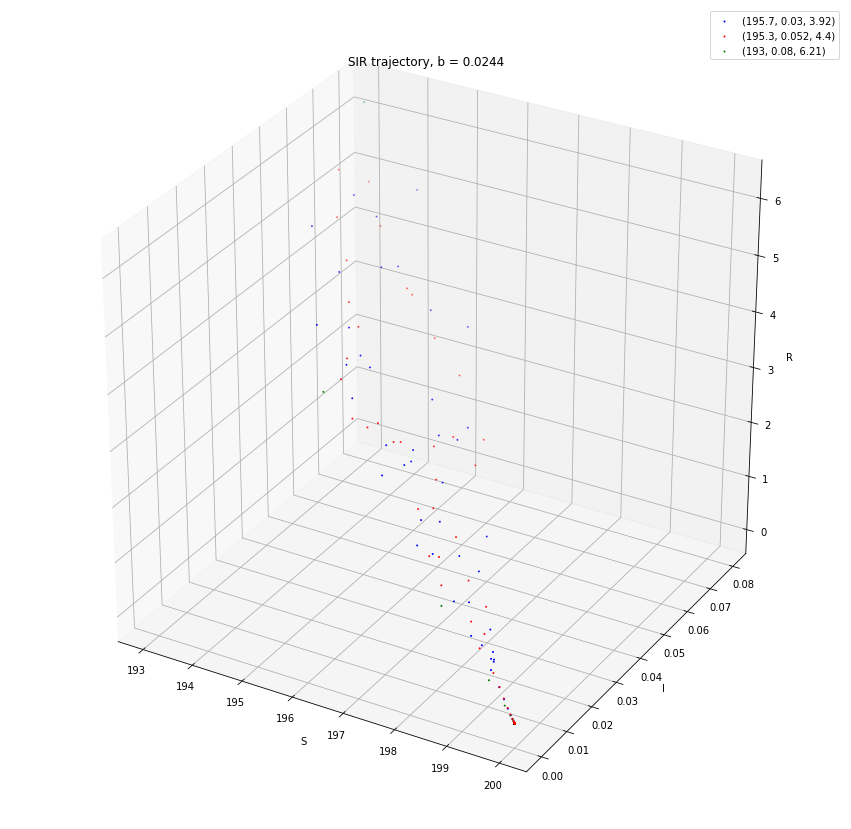

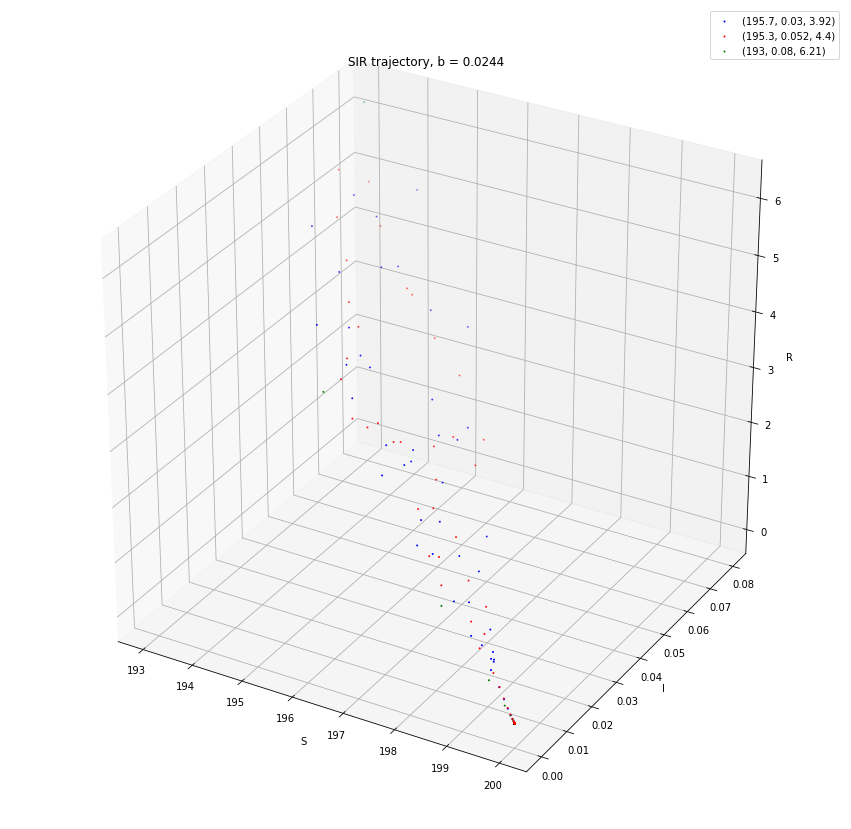

...

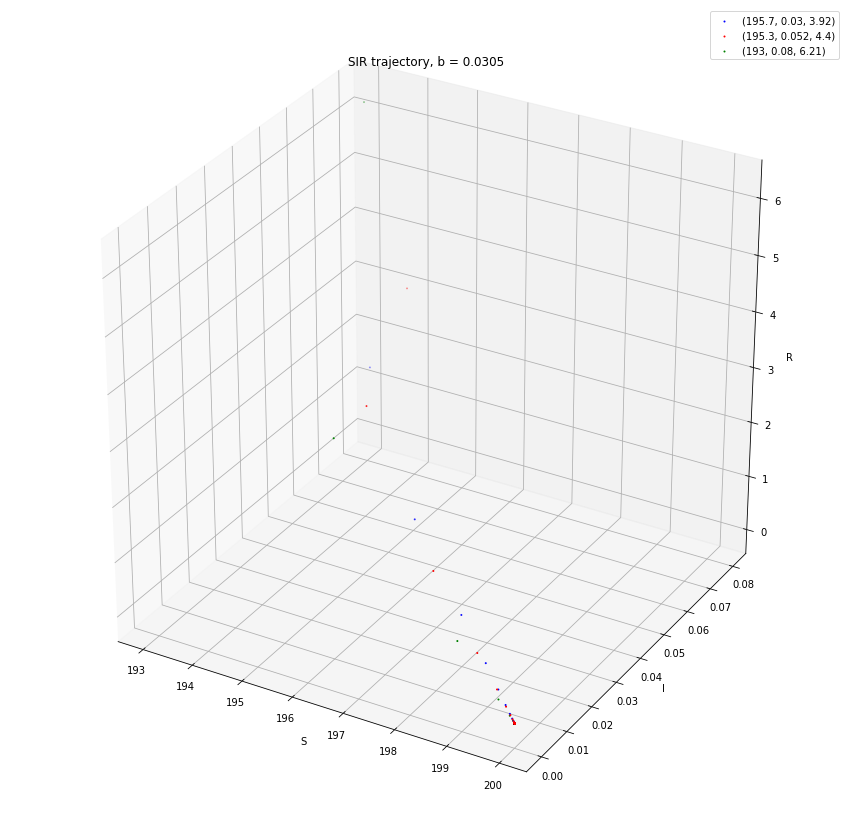

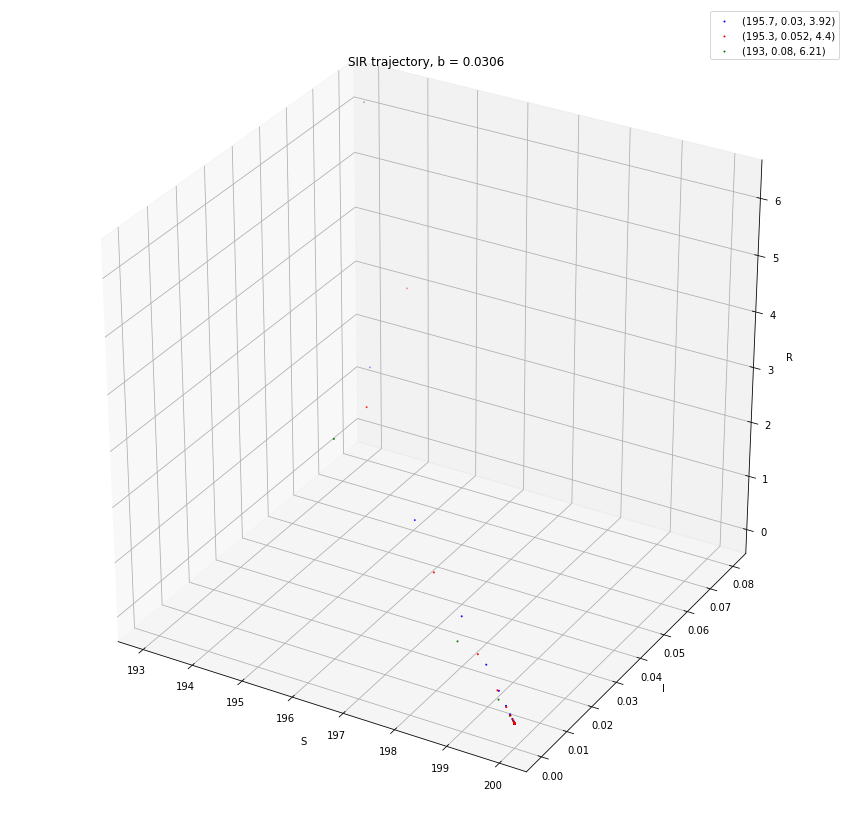

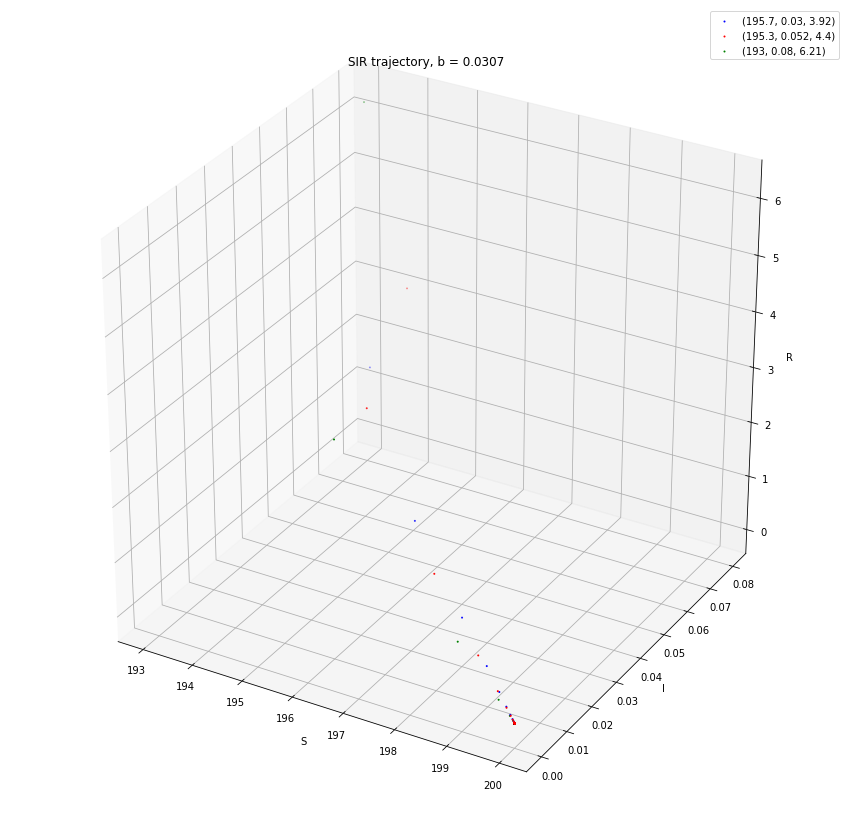

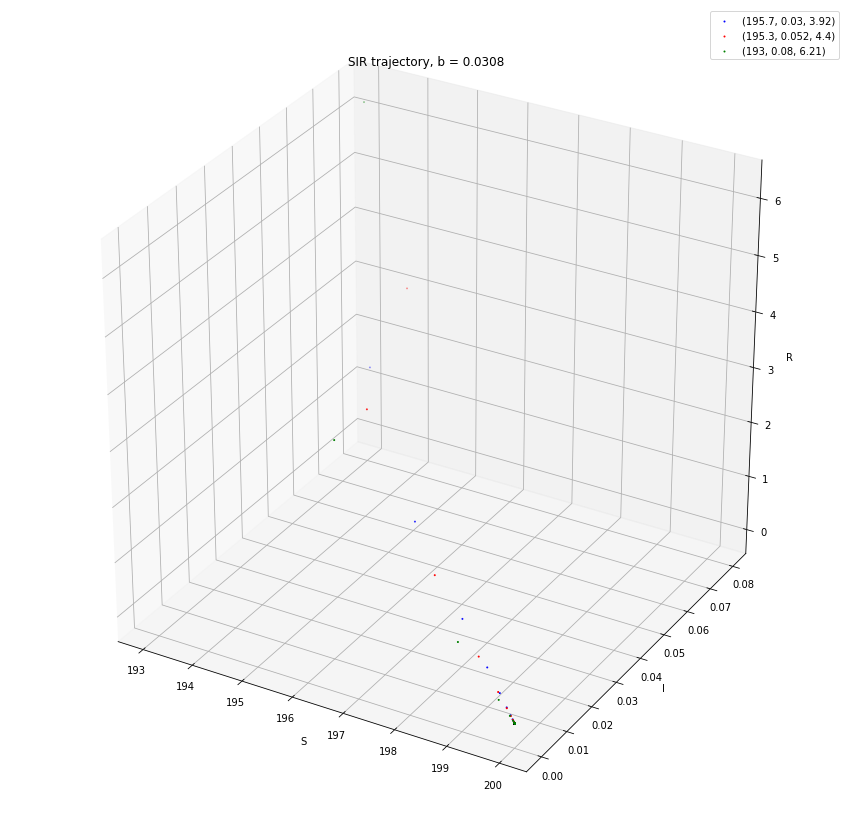

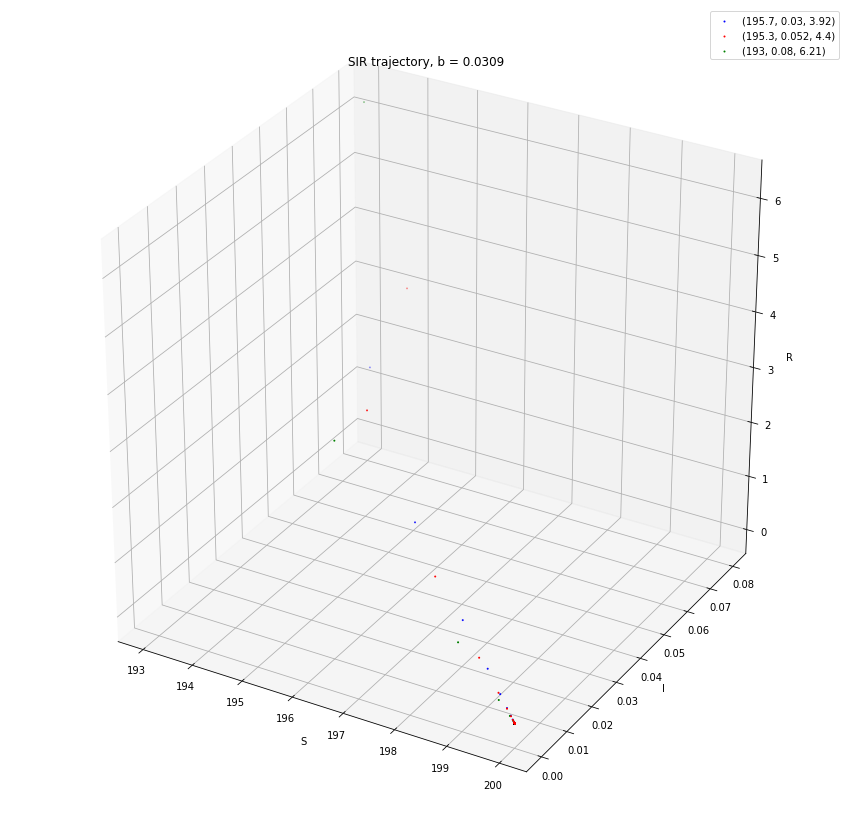

In [9]:
# add legend and make fig bigger

# parameters
random_state = 12345
t_0 = 0
t_end = 1000
NT = t_end-t_0
# if these error tolerances are set too high, the solution will be qualitatively (!) wrong
rtol=1e-8
atol=1e-8

# SIR model parameters
beta=11.5
A=20
d=0.1
nu=1
#b=0.01 # try to set this to 0.01, 0.020, ..., 0.022, ..., 0.03
mu0 = 10   # minimum recovery rate
mu1 = 10.45  # maximum recovery rate



B=np.arange(0.024,0.031,0.0001)
for i in range(len(B)):
    B[i] = my_ceil(B[i],4)

SIM0_1 = [195.7, 0.03, 3.92] # what happens with this initial condition when b=0. 􏰀→022?
SIM0_2 = [195.3, 0.052, 4.4]
SIM0_3 = [193, 0.08, 6.21]

    
for i in range(len(B)):
    fig1=plt.figure(figsize=(15,15))
    ax0=fig1.add_subplot(projection="3d")
    
    sol1 = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_1, t_eval=time,args=(mu0, mu1, beta, A, d, nu, B[i]), method='DOP853', rtol=rtol, atol=atol)
    ax0.scatter(sol1.y[0], sol1.y[1], sol1.y[2], s=1, c='blue',label="(195.7, 0.03, 3.92)");
    sol2 = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_2, t_eval=time,args=(mu0, mu1, beta, A, d, nu, B[i]), method='DOP853', rtol=rtol, atol=atol)
    ax0.scatter(sol2.y[0], sol2.y[1], sol2.y[2], s=1, c='red',label="(195.3, 0.052, 4.4)");
    sol3 = solve_ivp(model, t_span=[time[0],time[-1]], y0=SIM0_3, t_eval=time,args=(mu0, mu1, beta, A, d, nu, B[i]), method='DOP853', rtol=rtol, atol=atol)
    ax0.scatter(sol3.y[0], sol3.y[1], sol3.y[2], s=1, c='green',label="(193, 0.08, 6.21)");
    
    ax0.legend() 
    ax0.set_xlabel("S")
    ax0.set_ylabel("I")
    ax0.set_zlabel("R")
    ax0.set_title("SIR trajectory, b = {}".format(B[i]))
    fig1.show()

In [0]:
#fig.savefig('b_1000.png')

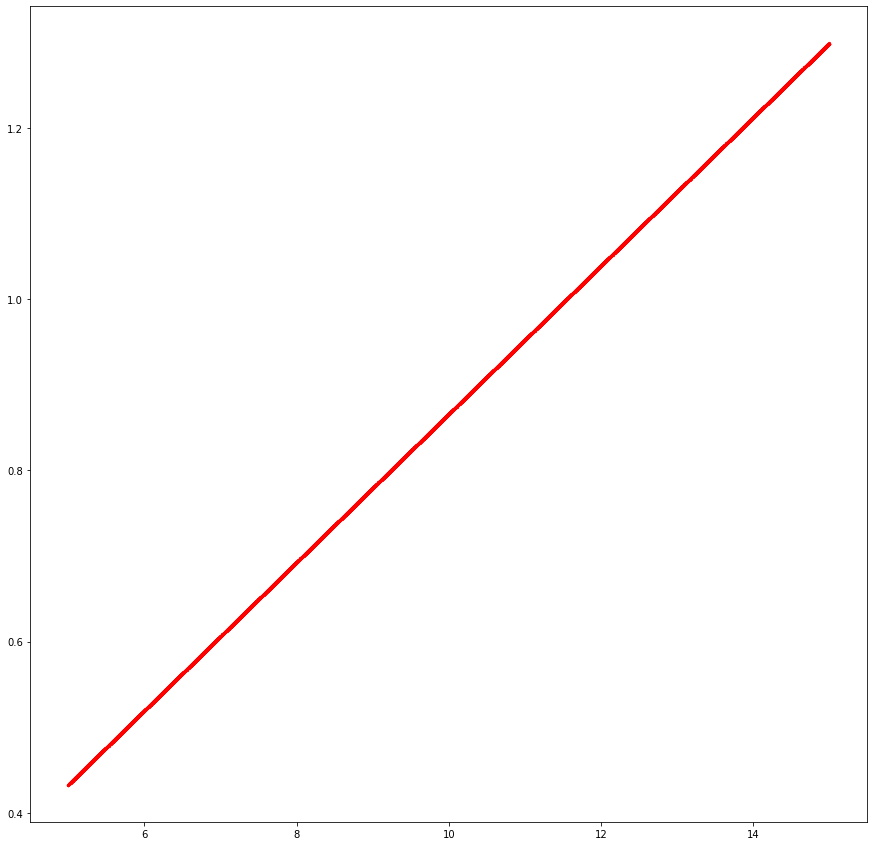

In [12]:
def plotReproduction():
    fig=plt.figure(figsize=(15,15))
    ax=fig.add_subplot()
    beta=11.5
    d=0.1
    nu=1
    mu1 = 10.45
    Beta = np.arange(5,15,0.001)
    for beta in Beta:
        point = R0(beta,d,nu,mu1)
        ax.scatter(beta, point, s=5, c='red', cmap=cmap3)
plotReproduction()